# Creating local estimates of boundary of basin of attraction

## Model a dynamical system

We model the Lorenz system, which consists of the following three ODEs: 

$$x'=\sigma(y-x) \\
y'=rx-y-xz \\
z'=xy-\beta z$$

In [13]:
import numpy as np
import math
from scipy.integrate import solve_ivp

We set some parameters and do a test simulation to observe the convergence process to a stable equilibrium. The simulation code is referenced from https://github.com/scipython/scipython-maths/blob/master/lorenz/lorenz.py

In [14]:
# Lorenz parameters and initial conditions.
sigma, beta, r = 10, 2.667, 10
x0, y0, z0 = 0, 1, 1.05

# Maximum time point and total number of time points.
tmax, n = 5000, 100000

In [15]:
def lorenz(t, X, sigma, beta, r):
    """The Lorenz equations."""
    x, y, z = X
    xp = sigma*(y - x)
    yp = r*x - y - x*z
    zp = -beta*z + x*y
    return xp, yp, zp

In [16]:
# Integrate the Lorenz equations.
soln = solve_ivp(lorenz, (0, tmax), (x0, y0, z0), args=(sigma, beta, r),dense_output=True)
# Interpolate solution onto the time grid, t.
t = np.linspace(0, tmax, n)
x, y, z = soln.sol(t)

After numerically solving the problem, we plot the trajectory.

In [17]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

In [18]:
WIDTH, HEIGHT, DPI = 1000, 750, 100

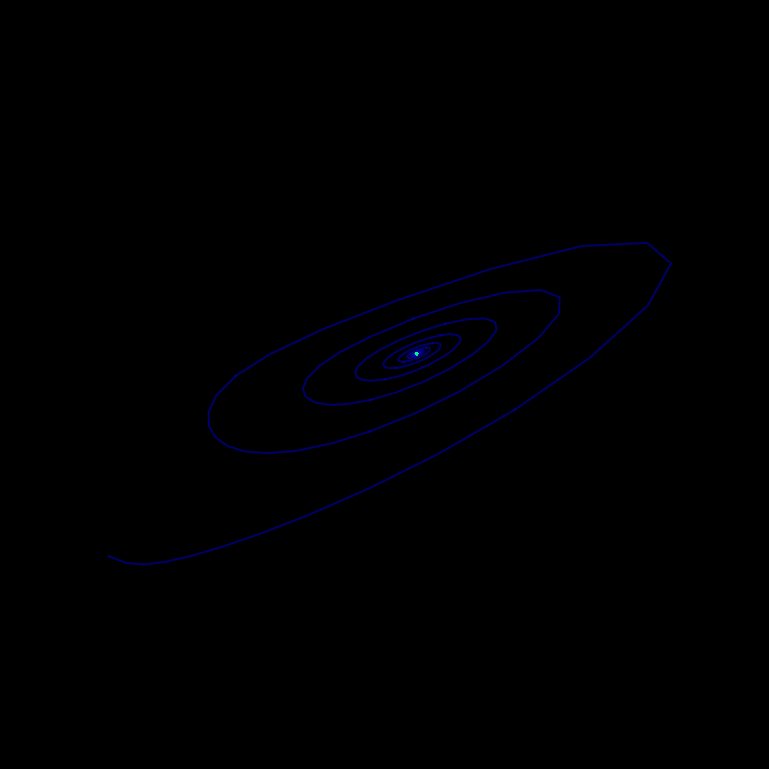

In [19]:
# Plot the Lorenz attractor using a Matplotlib 3D projection.
fig = plt.figure(facecolor='k', figsize=(WIDTH/DPI, HEIGHT/DPI))
ax = fig.add_subplot(111, projection='3d')
ax.set_facecolor('k')
fig.subplots_adjust(left=0, right=1, bottom=0, top=1)

# Make the line multi-coloured by plotting it in segments of length s which
# change in colour across the whole time series.
s = 10
cmap = plt.cm.winter
for i in range(0,n-s,s):
    ax.plot(x[i:i+s+1], y[i:i+s+1], z[i:i+s+1], color=cmap(i/n), alpha=0.4)

# Remove all the axis clutter, leaving just the curve.
ax.set_axis_off()

plt.savefig('lorenz_win.png', dpi=DPI)
plt.show()

By the setting of parameters, the system has two stable equilibriums. 

By checking the trace of the trajectory, we could observe that the flow converges to one of them.

## Simulation to collect data

We now form a dataset for training and testing with the following way: We randomly select initial conditions $(x_{0},y_{0},z_{0}) \in (-50,50)\times (-50,50) \times (-50,50)$ and compute the trajectories. We fix a stable equilibrium of interest, and label the points as 1 or -1 depending on whether the trajectory converges to that equilibrium. With the above set of parameters, we have that $(\sqrt{24}, \sqrt{24}, 9)$ is a stable equilibrium. We therefore obtain a dataset by simulating the trajectory of 500 sample points. If the trajectory is attracted, we label it as +1, otherwise -1.

In [20]:
# Check if the trajectory is attracted to the concerned Lorenz attractor
def is_attracted(x, y, z):
    return (abs(x-math.sqrt(24))<0.01) and (abs(y-math.sqrt(24))<0.01) and (abs(z-9)<0.01)

In [21]:
## Implement the simulation process and decide if the trajectory is attracted by the Lorenz attractor
def simulation(x0 ,y0 ,z0):
    tmax, n = 1500, 100000
    soln = solve_ivp(lorenz, (0, tmax), (x0, y0, z0), args=(sigma, beta, r),dense_output=True)
    t = np.linspace(0, tmax, n)
    x, y, z = soln.sol(t)
    return is_attracted(x[n-1], y[n-1], z[n-1])

In [22]:
def generate_random_points():
    x0 = np.random.uniform(-50, 50)
    y0 = np.random.uniform(-50, 50)
    z0 = np.random.uniform(-50, 50)
    return x0, y0, z0

In [ ]:
import pandas as pd

# Create the dataset
df = pd.DataFrame(columns=['x0', 'y0', 'z0', 'attracted'])
for i in range(100000):
    x0, y0, z0 = generate_random_points()
    attracted_result = simulation(x0, y0, z0)
    attracted_result = 1 if attracted_result else -1  # map True to 1 and False to -1
    df.loc[i] = [x0, y0, z0, attracted_result]
    if i % 1000 == 0:  # print progress every 1000 iterations
        print(f"Progress: {i}/100000")

# Save the DataFrame to a CSV file
df.to_csv('dataset_large.csv', index=False)

## Reproduction of Shena et.al approach using deep neural network

With dataset generated, we will train a neural network to perform logistic regression by minimizing cross-entropy loss.

In [23]:
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, Dataset
import torch.optim as optim

In [24]:
## Load the dataset
class LorenzDataset(Dataset):
    def __init__(self, csv_file):
        self.data = pd.read_csv(csv_file)

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        features = torch.tensor([self.data.iloc[idx].x0, self.data.iloc[idx].y0, self.data.iloc[idx].z0]).float()
        label = torch.tensor(self.data.iloc[idx].attracted).float()
        return features, label
    
dataset = LorenzDataset('dataset_large.csv')

dataset_train, dataset_test = torch.utils.data.random_split(dataset, [80000, 20000])

dataloader_train = DataLoader(dataset_train, batch_size=32, shuffle=True)

In [25]:
features, labels = next(iter(dataloader_train))
print(features, labels)

tensor([[ 8.4611e+00,  4.8141e+01, -3.2344e+01],
        [ 1.0006e+01, -4.1045e+01,  1.9911e+01],
        [-3.3177e+01, -4.9649e+01, -2.0052e+01],
        [ 3.5050e+01, -1.9930e+01, -4.9210e+01],
        [-4.9966e+00,  3.7456e+01,  4.6700e+01],
        [-1.4467e+01,  4.7277e+01,  1.9482e+01],
        [-6.7192e+00, -3.0211e+01, -3.9697e+01],
        [ 1.0493e+01, -1.9924e+01, -2.4350e+01],
        [ 2.8863e+00,  2.9950e+01, -3.8191e+01],
        [-2.4348e+00, -1.6442e+01,  2.0645e+01],
        [ 4.4086e+01, -4.3142e+01,  4.7481e+01],
        [-3.9687e+01,  1.5688e+01,  1.7869e+01],
        [ 2.4121e+01, -1.0299e+00, -1.1512e+01],
        [ 2.9570e+01, -4.8968e+01, -2.1746e+01],
        [ 9.4919e+00, -3.9819e-02,  7.7115e+00],
        [-3.1251e+01, -4.7721e+01, -1.3548e+00],
        [-6.1015e+00, -4.5540e+01,  1.3914e+01],
        [ 3.8067e+01, -1.0511e+01,  4.9577e+01],
        [-4.0599e+01, -2.7925e+01, -1.7531e+01],
        [ 4.6443e+01, -4.3532e+01, -3.7068e+01],
        [ 2.7744e+01

In [26]:
## Define the neural network
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        self.fc1 = nn.Linear(3, 64)
        self.fc2 = nn.Linear(64, 32)
        self.fc3 = nn.Linear(32, 1)

    def forward(self, x):
        x = torch.relu(self.fc1(x))
        x = torch.relu(self.fc2(x))
        x = torch.sigmoid(self.fc3(x))
        return x
    
net = Net()

In [27]:
## Set up loss and optimizer
criterion = nn.BCELoss()
optimizer = optim.Adam(net.parameters(), lr=0.001)

In [28]:
# Check if CUDA is available and set the device accordingly
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Move the model to the device
net = net.to(device)

## Train the network
for epoch in range(100):  # loop over the dataset multiple times
    running_loss = 0.0
    mini_batch_count = 0
    for features, labels in dataset_train:
        # Ensure features is a Tensor
        if not isinstance(features, torch.Tensor):
            features = torch.Tensor(features)

        # Ensure labels is a Tensor
        if not isinstance(labels, torch.Tensor):
            labels = torch.Tensor(labels)

        # Convert labels from -1 or 1 to 0 or 1
        labels = ((labels + 1) / 2).float()

        # Reshape labels to match the output shape
        labels = labels.view(-1)

        # Move the features and labels to the device
        features = features.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()
        outputs = net(features)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()
        mini_batch_count += 1
        if mini_batch_count % 10 == 0:    # print every 10 mini-batches
            print('[%d, %5d] loss: %.3f' %
                (epoch + 1, mini_batch_count, running_loss / 10))
            running_loss = 0.0
    print('Finished training for epoch %d, loss: %.3f' % (epoch + 1, running_loss / len(dataset_train)))

[1,    10] loss: 2.017
[1,    20] loss: 1.005
[1,    30] loss: 0.673
[1,    40] loss: 0.848
[1,    50] loss: 0.359
[1,    60] loss: 1.068
[1,    70] loss: 0.968
[1,    80] loss: 0.792
[1,    90] loss: 0.538
[1,   100] loss: 0.889
[1,   110] loss: 0.581
[1,   120] loss: 1.338
[1,   130] loss: 1.255
[1,   140] loss: 0.893
[1,   150] loss: 0.920
[1,   160] loss: 1.051
[1,   170] loss: 0.758
[1,   180] loss: 0.695
[1,   190] loss: 1.031
[1,   200] loss: 0.865
[1,   210] loss: 0.963
[1,   220] loss: 0.888
[1,   230] loss: 0.502
[1,   240] loss: 0.940
[1,   250] loss: 0.835
[1,   260] loss: 0.636
[1,   270] loss: 0.882
[1,   280] loss: 1.293
[1,   290] loss: 0.749
[1,   300] loss: 0.674
[1,   310] loss: 0.717
[1,   320] loss: 0.614
[1,   330] loss: 1.271
[1,   340] loss: 0.696
[1,   350] loss: 0.531
[1,   360] loss: 0.996
[1,   370] loss: 0.678
[1,   380] loss: 0.895
[1,   390] loss: 0.698
[1,   400] loss: 0.930
[1,   410] loss: 0.912
[1,   420] loss: 1.088
[1,   430] loss: 0.749
[1,   440] 

Accuracy: 0.9287999868392944


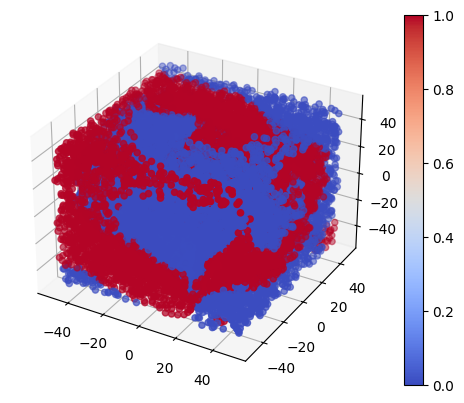

In [30]:
## Test the network and plot the results
from torchmetrics import Accuracy
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np

features_list = []
labels_list = []
predictions_list = []
acc = Accuracy(task = 'binary')

dataloader_test = DataLoader(dataset_test, batch_size=1, shuffle=False)

with torch.no_grad():
    for features, labels in dataloader_test:
        features = features.to(device)
        labels = labels.to(device)
        labels = ((labels + 1) / 2).float()
        outputs = (net(features) >= 0.5).float()
        outputs = outputs.squeeze(0)

        acc.update(outputs, labels)

        # Move features, labels, and outputs to CPU and convert them to numpy arrays
        features_list.append(features.cpu().numpy())
        labels_list.append(labels.cpu().numpy())
        predictions_list.append(outputs.cpu().numpy())
accuracy = acc.compute()
print(f'Accuracy: {accuracy}')

# Concatenate all batches
features = np.concatenate(features_list, axis=0)
labels = np.concatenate(labels_list, axis=0)
predictions = np.concatenate(predictions_list, axis=0)

# Create a 3D scatter plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Plot the features colored by the predictions
scatter = ax.scatter(features[:, 0], features[:, 1], features[:, 2], c=predictions, cmap='coolwarm')

# Add a color bar
plt.colorbar(scatter)

plt.show()

In [31]:
## Save the model
torch.save(net.state_dict(), 'lorenz_model_mac.pth')

In [32]:
## Code to reload the model
net = Net()

# Load the model
net.load_state_dict(torch.load('lorenz_model_mac.pth'))

<All keys matched successfully>